# E-Commerce Delivery EDA


In [163]:
import pandas as pd
import numpy as np
import string
from mygraphs import create_boxplots, create_histograms, create_graphs, create_boxplots2
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from imblearn.over_sampling import SMOTE
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score, classification_report
from sklearn.metrics import roc_curve, RocCurveDisplay, roc_auc_score, confusion_matrix, ConfusionMatrixDisplay

## Initialize the dataframe, etc...

In [164]:
df = pd.read_csv('train.csv')

In [165]:
df.head()

,ID,Warehouse_block,Mode_of_Shipment,Customer_care_calls,Customer_rating,Cost_of_the_Product,Prior_purchases,Product_importance,Gender,Discount_offered,Weight_in_gms,Reached.on.Time_Y.N
0,1,D,Flight,4,2,177,3,low,F,44,1233,1
1,2,F,Flight,4,5,216,2,low,M,59,3088,1
2,3,A,Flight,2,2,183,4,low,M,48,3374,1
3,4,B,Flight,3,3,176,4,medium,M,10,1177,1
4,5,C,Flight,2,2,184,3,medium,F,46,2484,1


In [166]:

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10999 entries, 0 to 10998
Data columns (total 12 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   ID                   10999 non-null  int64 
 1   Warehouse_block      10999 non-null  object
 2   Mode_of_Shipment     10999 non-null  object
 3   Customer_care_calls  10999 non-null  int64 
 4   Customer_rating      10999 non-null  int64 
 5   Cost_of_the_Product  10999 non-null  int64 
 6   Prior_purchases      10999 non-null  int64 
 7   Product_importance   10999 non-null  object
 8   Gender               10999 non-null  object
 9   Discount_offered     10999 non-null  int64 
 10  Weight_in_gms        10999 non-null  int64 
 11  Reached.on.Time_Y.N  10999 non-null  int64 
dtypes: int64(8), object(4)
memory usage: 1.0+ MB


In [167]:
create_boxplots(df, 4)

In [168]:
create_graphs(df, 3)

In [169]:

df_int = df.select_dtypes(include=[np.int64])

### The distributions are odd in Prior_purchases, Discount_offered and Weight_in_gms.  However there is no reason to change them at this time, we'll later look at correlations

In [170]:
df_obj = df.select_dtypes(include=[np.object])
df_obj.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10999 entries, 0 to 10998
Data columns (total 4 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Warehouse_block     10999 non-null  object
 1   Mode_of_Shipment    10999 non-null  object
 2   Product_importance  10999 non-null  object
 3   Gender              10999 non-null  object
dtypes: object(4)
memory usage: 343.8+ KB


### No missingness found in the DF, no NaN type encoding hidden in the categorical variables

In [171]:
df_int.corr()['Reached.on.Time_Y.N']

ID                    -0.411822
Customer_care_calls   -0.067126
Customer_rating        0.013119
Cost_of_the_Product   -0.073587
Prior_purchases       -0.055515
Discount_offered       0.397108
Weight_in_gms         -0.268793
Reached.on.Time_Y.N    1.000000
Name: Reached.on.Time_Y.N, dtype: float64

In [172]:
# Assuming df is your DataFrame
corr = df.corr()

mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

plt.show()

### Strongest correlation is ID and Discount_offered.  ID we know is just a sequential identifier (the correlation seems to be because the first ~1/4 of the data is all on_time= 1 for some reason), so well drop ID.

In [173]:
df_int = df_int.drop(columns='ID', axis=1)

In [174]:
sns.pairplot(df)
plt.show()

### It appears that there data source is not pulled from a normal distribution, with respect to the weight_in_grams.  For instance:
- Up until ID ~3000, there are essentiall zero values above 4000.  Then after ID~3000 there are only values 1-2k and 4-6k
- Cost_of_the_product has a hole for the 2-4k wieght range between 0 and ~175, then again for >2k wieght for cost > ~275
- Discount_offered caps at about weigh=4500 after ~15
- Most importantly, there is a hole in our target variable Reached.on.Time_Y.N=0 for weights ~2000 to 4000.

Due to this apparent strangeness/missingness in the distribution, we should consider not using weight_in_grams in the model

In [175]:
create_boxplots2(df, 4)

### The one categorical variable that stands out as different than the others is Product_importance='high'.  In the boxplots above, it is visually different than its counterparts 'low' and 'medium' in the numeric variables 'weigh_in_grams', 'discount_offered', 'prior_purchases' and even 'ID'.

## Some feature engineering...

<AxesSubplot:xlabel='Weight_in_gms', ylabel='Count'>

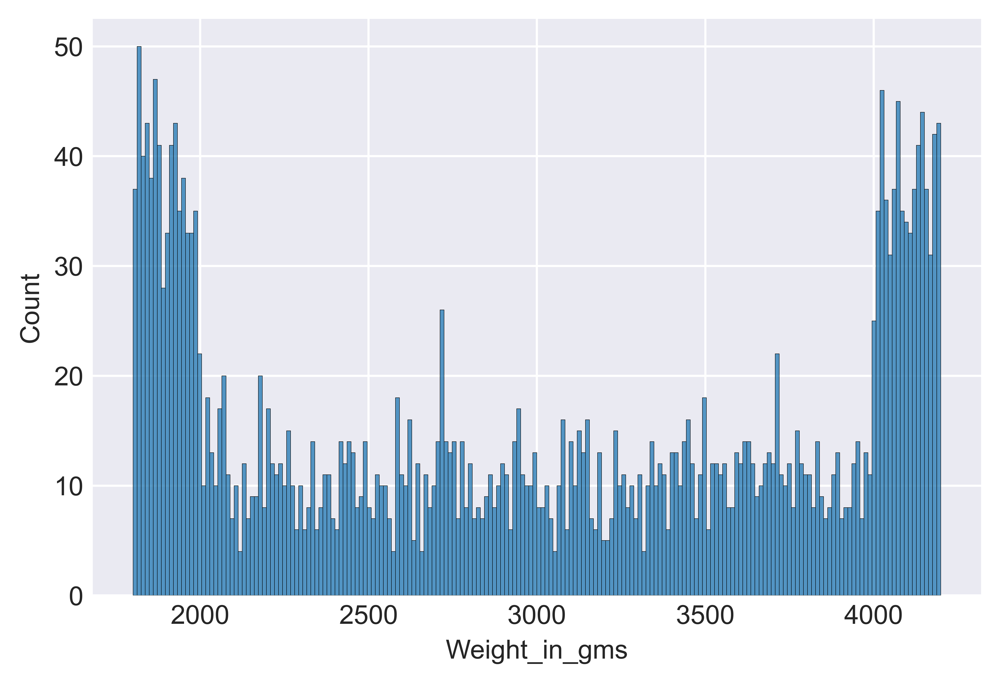

In [203]:
sns.histplot(df[(df['Weight_in_gms'] > 1800) & (df['Weight_in_gms'] < 4200)]['Weight_in_gms'], bins=200)


In [204]:
df['wt_2000_4000'] = df['Weight_in_gms'].apply(lambda x: 1 if x > 2000 and x < 4000 else 0)


## Create feature sets, target sets

In [178]:
# Generate dummy columns from df_int using OneHotEncoder
encoder = OneHotEncoder()
df_obj_encoded = encoder.fit_transform(df_obj)
df_obj_encoded = pd.DataFrame(df_obj_encoded.toarray(), columns=encoder.get_feature_names(df_obj.columns))
df_obj_encoded

c:\Users\daled\anaconda3\envs\learn-env\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,Warehouse_block_A,Warehouse_block_B,Warehouse_block_C,Warehouse_block_D,Warehouse_block_F,Mode_of_Shipment_Flight,Mode_of_Shipment_Road,Mode_of_Shipment_Ship,Product_importance_high,Product_importance_low,Product_importance_medium,Gender_F,Gender_M
0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
1,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
2,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
3,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
4,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10994,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0
10995,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0
10996,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
10997,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0


In [179]:
df_int = df_int.drop(columns=['Reached.on.Time_Y.N'], axis=1)
X = pd.concat([df_int, df_obj_encoded], axis=1)
X_names = X.columns
X.head()


,Customer_care_calls,Customer_rating,Cost_of_the_Product,Prior_purchases,Discount_offered,Weight_in_gms,Warehouse_block_A,Warehouse_block_B,Warehouse_block_C,Warehouse_block_D,Warehouse_block_F,Mode_of_Shipment_Flight,Mode_of_Shipment_Road,Mode_of_Shipment_Ship,Product_importance_high,Product_importance_low,Product_importance_medium,Gender_F,Gender_M
0,4,2,177,3,44,1233,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
1,4,5,216,2,59,3088,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
2,2,2,183,4,48,3374,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
3,3,3,176,4,10,1177,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
4,2,2,184,3,46,2484,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0


In [180]:
y = df['Reached.on.Time_Y.N']

In [181]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

In [182]:
# There the response classes are not evenly distributed...
y_train.value_counts()

1    5258
0    3541
Name: Reached.on.Time_Y.N, dtype: int64

## Baseline Decision Tree Classifier Model

In [186]:
# Trying logistic regresssion for a baseline model
tree_model = DecisionTreeClassifier(random_state=42, max_depth=5, min_samples_split=2, min_samples_leaf=1, max_features=None, criterion='gini')
tree_model.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=5, random_state=42)

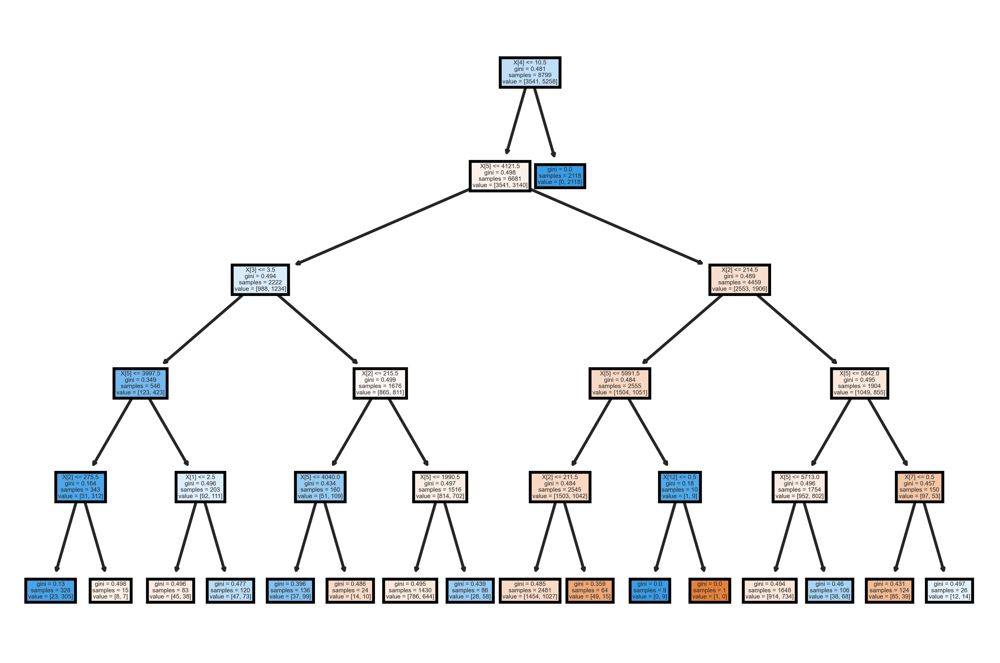

In [187]:
plot_tree(tree_model, filled=True);

### Clearly over-fitted!  

## Baseline Model Results:

In [188]:
y_pred_train = tree_model.predict(X_train)
y_pred_test = tree_model.predict(X_test)
print('TRAINING SET CLASSIFICATION REPORT')
print(classification_report(y_train, y_pred_train))
print('-------------------------------------')
print('TEST SET CLASSIFICATION REPORT')
print(classification_report(y_test, y_pred_test))
print('-------------------------------------')

TRAINING SET CLASSIFICATION REPORT
              precision    recall  f1-score   support

           0       0.57      0.95      0.71      3541
           1       0.94      0.52      0.67      5258

    accuracy                           0.69      8799
   macro avg       0.75      0.73      0.69      8799
weighted avg       0.79      0.69      0.69      8799

-------------------------------------
TEST SET CLASSIFICATION REPORT
              precision    recall  f1-score   support

           0       0.57      0.92      0.70       895
           1       0.91      0.52      0.66      1305

    accuracy                           0.69      2200
   macro avg       0.74      0.72      0.68      2200
weighted avg       0.77      0.69      0.68      2200

-------------------------------------


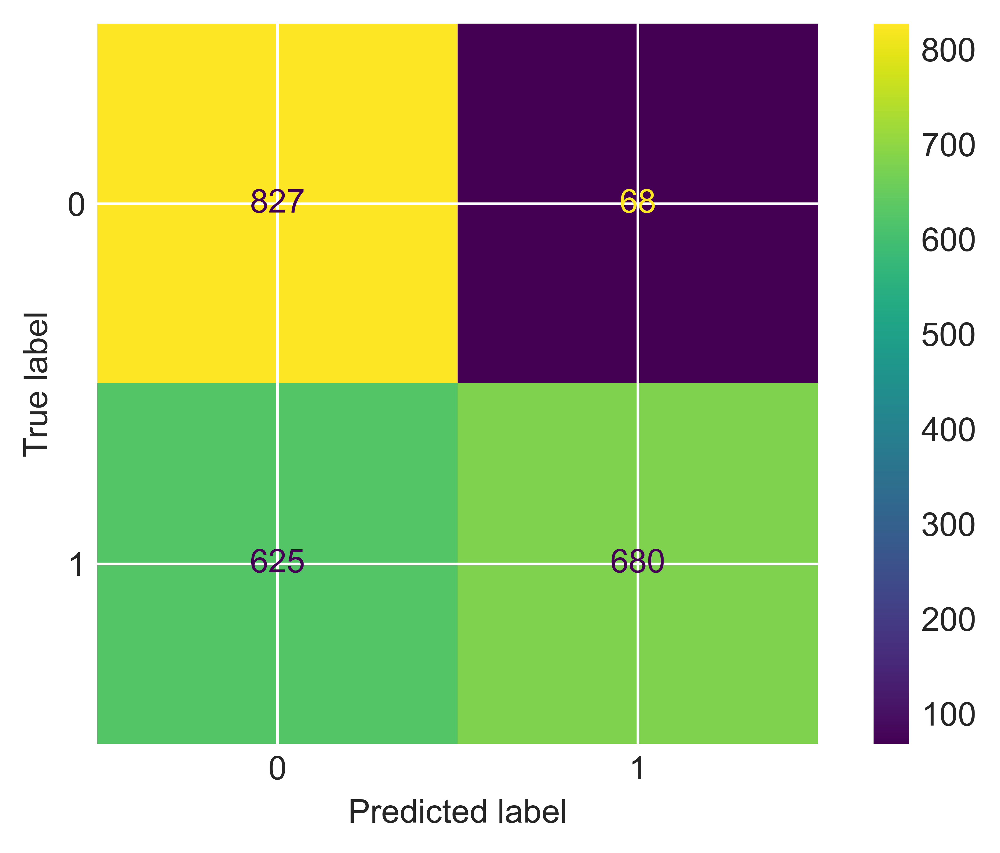

In [189]:
conf_matrix = confusion_matrix(y_test, y_pred_test)
cmd = ConfusionMatrixDisplay(conf_matrix)
cmd.plot();

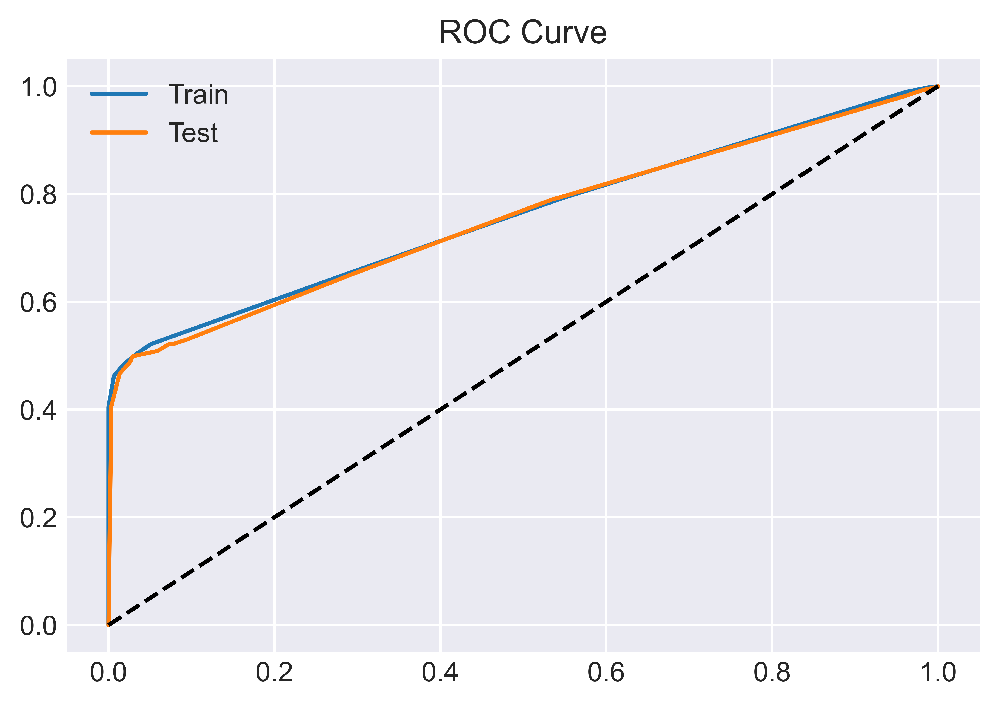

In [190]:
y_test_score = tree_model.predict_proba(X_test)[:, 1]
y_train_score = tree_model.predict_proba(X_train)[:, 1]

test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_score)
train_fpr, train_tpr, thresholds = roc_curve(y_train, y_train_score)

# Plot the ROC curves
plt.plot(train_fpr, train_tpr, label='Train')
plt.plot(test_fpr, test_tpr, label='Test')
plt.plot([0, 1], [0, 1], 'k--')
plt.legend()
plt.title('ROC Curve')
plt.show()

### Not good results for the baseline model. Very much over-fitted; the training set is perfect and the test set is barely better than coin-flip.

## Decision Tree Classifier Model - With 'Manual' Hyperparameter Tuning

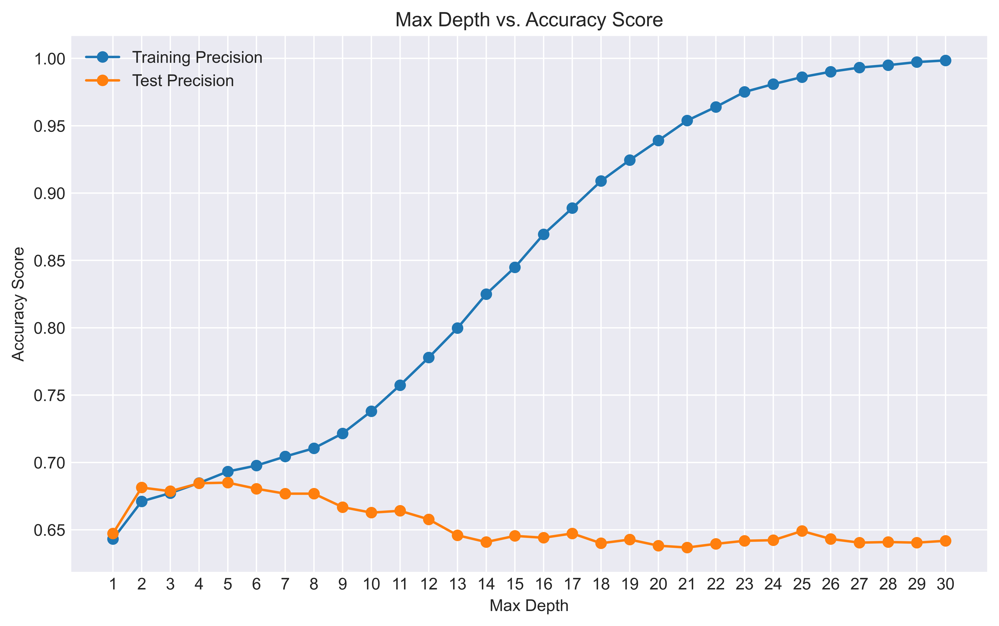

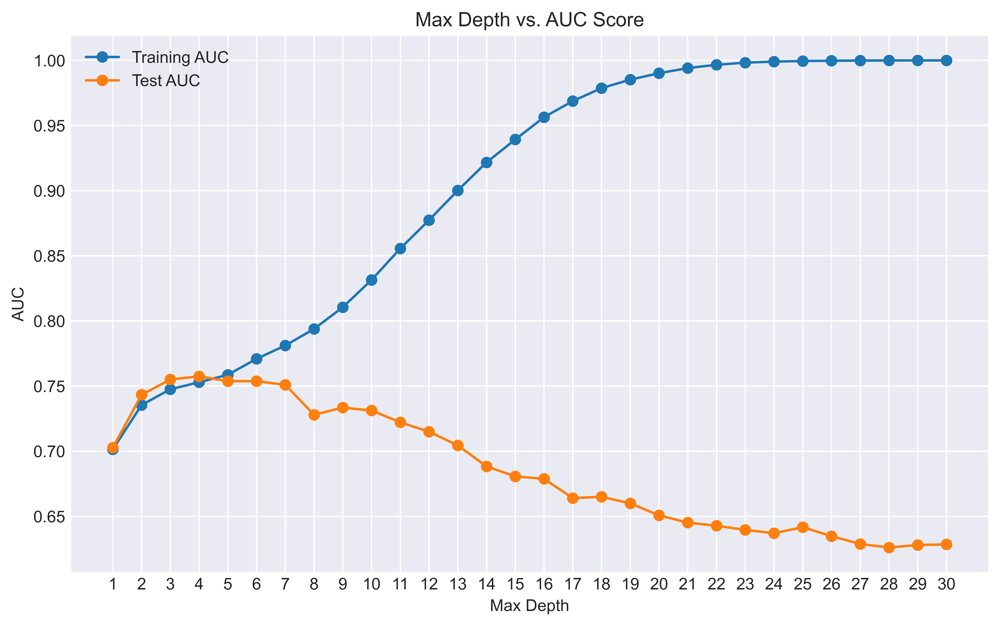

In [191]:
plt.style.use('seaborn-darkgrid')

acc_train = []
auc_train = []
acc_test = []
auc_test = []
x_range = np.arange(1, 31, 1)

for max_depth in x_range:
    model = DecisionTreeClassifier(random_state=45, max_depth=max_depth)
    model.fit(X_train, y_train)
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)

    acc_train.append(accuracy_score(y_train, y_pred_train))
    auc_train.append(roc_auc_score(y_train, model.predict_proba(X_train)[:, 1]))
    acc_test.append(accuracy_score(y_test, y_pred_test))
    auc_test.append(roc_auc_score(y_test, model.predict_proba(X_test)[:, 1]))


# Create a new figure for Precision
plt.figure(figsize=(10, 6))
plt.plot(x_range, acc_train, label='Training Precision', marker='o')
plt.plot(x_range, acc_test, label='Test Precision', marker='o')
plt.xlabel('Max Depth')
plt.ylabel('Accuracy Score')
plt.title('Max Depth vs. Accuracy Score')
plt.xticks(x_range)  # Set x-axis ticks to be x_range values
plt.legend()
plt.show()

# Create a new figure for AUC
plt.figure(figsize=(10, 6))
plt.plot(x_range, auc_train, label='Training AUC', marker='o')
plt.plot(x_range, auc_test, label='Test AUC', marker='o')
plt.xlabel('Max Depth')
plt.ylabel('AUC')
plt.title('Max Depth vs. AUC Score')
plt.xticks(x_range)  # Set x-axis ticks to be x_range values
plt.legend()
plt.show()

In [192]:
# Trying logistic regresssion for a baseline model
tree_model = DecisionTreeClassifier(random_state=42, max_depth=4)
tree_model.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=4, random_state=42)

In [193]:
plt.rcParams['figure.dpi'] = 900  # e.g. 300, 600, 1200
plt.figure(figsize=(15,10))  # Set the figure size
plot_tree(tree_model, feature_names=X_names, filled=True, rounded=True)
plt.show()


In [194]:
y_pred_train = tree_model.predict(X_train)
y_pred_test = tree_model.predict(X_test)
print('TRAINING SET CLASSIFICATION REPORT')
print(classification_report(y_train, y_pred_train))
print('-------------------------------------')
print('TEST SET CLASSIFICATION REPORT')
print(classification_report(y_test, y_pred_test))
print('-------------------------------------')

TRAINING SET CLASSIFICATION REPORT
              precision    recall  f1-score   support

           0       0.56      0.95      0.71      3541
           1       0.94      0.51      0.66      5258

    accuracy                           0.68      8799
   macro avg       0.75      0.73      0.68      8799
weighted avg       0.79      0.68      0.68      8799

-------------------------------------
TEST SET CLASSIFICATION REPORT
              precision    recall  f1-score   support

           0       0.57      0.94      0.71       895
           1       0.92      0.51      0.66      1305

    accuracy                           0.68      2200
   macro avg       0.75      0.72      0.68      2200
weighted avg       0.78      0.68      0.68      2200

-------------------------------------


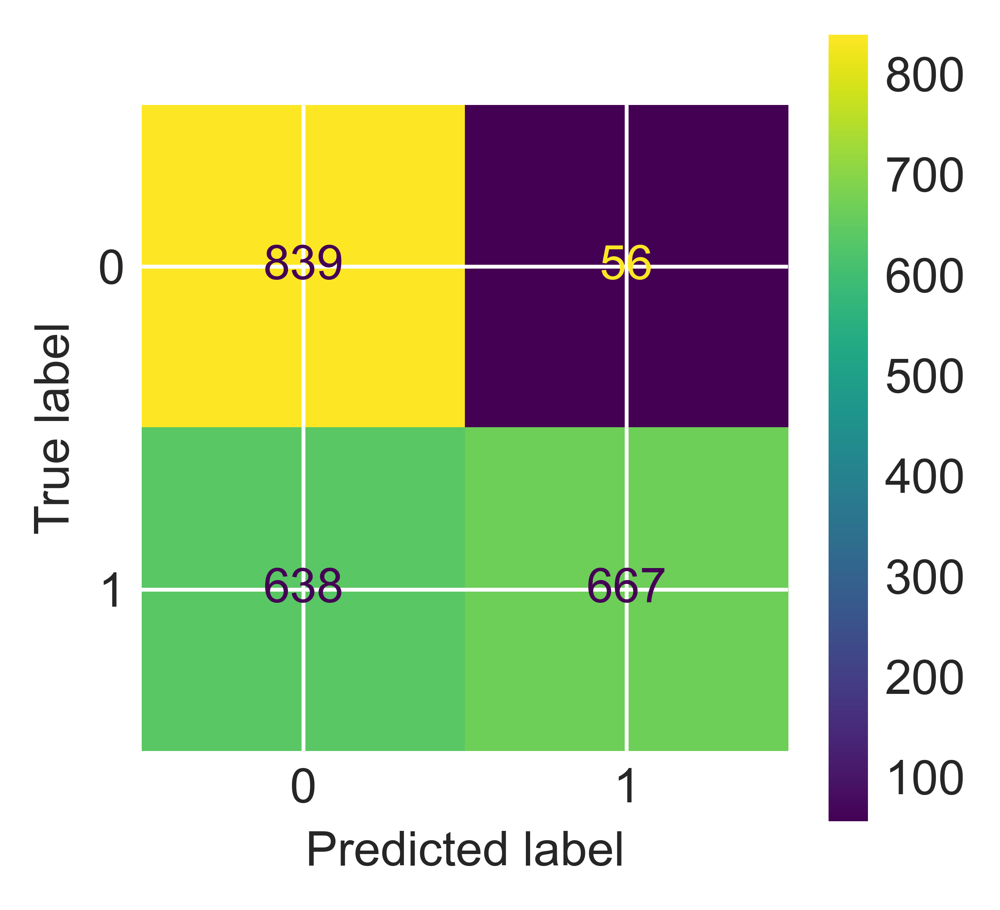

In [195]:
# Assuming y_test and y_pred_test are defined
conf_matrix = confusion_matrix(y_test, y_pred_test)

# Create a figure and a set of subplots with custom size
fig, ax = plt.subplots(figsize=(3, 3))  # Adjust the figure size as needed

# Plot the confusion matrix on the created axes
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)
disp.plot(ax=ax)  # Pass the axes to the plot method

plt.show()

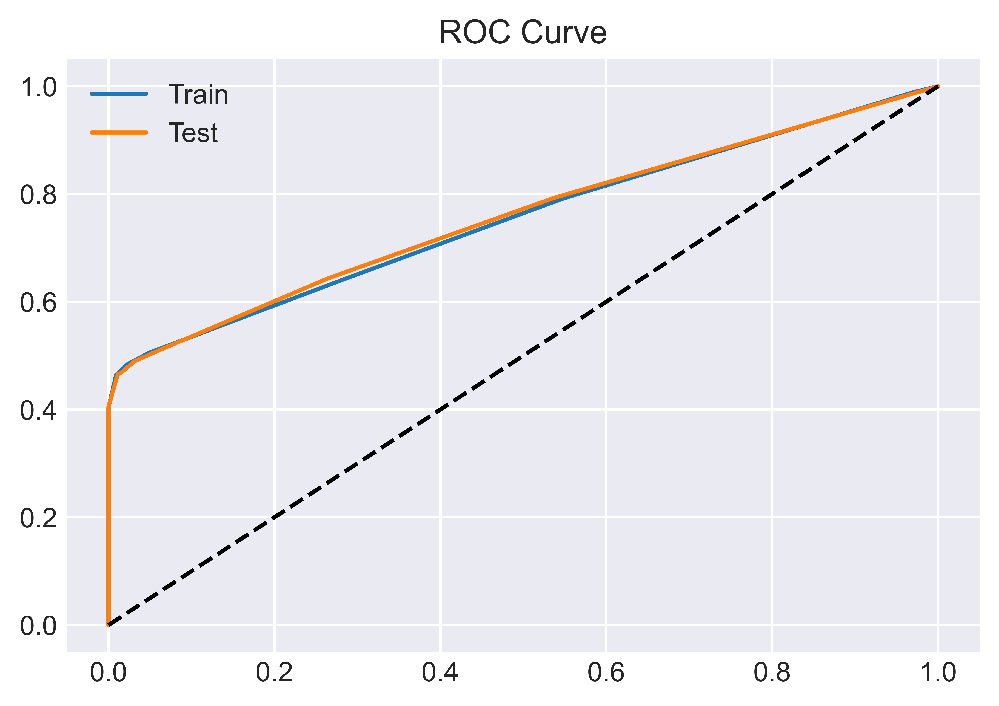

In [196]:
y_test_score = tree_model.predict_proba(X_test)[:, 1]
y_train_score = tree_model.predict_proba(X_train)[:, 1]

test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_score)
train_fpr, train_tpr, thresholds = roc_curve(y_train, y_train_score)

# Plot the ROC curves
plt.plot(train_fpr, train_tpr, label='Train')
plt.plot(test_fpr, test_tpr, label='Test')
plt.plot([0, 1], [0, 1], 'k--')
plt.legend()
plt.title('ROC Curve')
plt.show()

### Not good results for the baseline model. Very much over-fitted; the training set is perfect and the test set is barely better than coin-flip.

## Grid Search Best Decision Tree Params

In [197]:
# Define parameter grid
param_grid = {
    'criterion': ['gini', 'entropy'],
    'max_depth': range(1, 10),
    'min_samples_split': range(2, 10),
    'min_samples_leaf': range(1, 5)
}


# Initialize GridSearchCV
grid_search = GridSearchCV(estimator=tree_model, param_grid=param_grid, cv=5, scoring='accuracy')

# Fit GridSearchCV
grid_search.fit(X_train, y_train)

# Best parameters and best score
print("Best Parameters:", grid_search.best_params_)
print("Best Score:", grid_search.best_score_)

# Evaluate on Test Data
best_model = grid_search.best_estimator_
test_accuracy = best_model.score(X_test, y_test)
print("Test Accuracy:", test_accuracy)

Best Parameters: {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 1, 'min_samples_split': 2}
Best Score: 0.6831472556721276
Test Accuracy: 0.685


In [199]:
# Trying logistic regresssion for a baseline model
tree_model = DecisionTreeClassifier(criterion='entropy', random_state=42, max_depth=5, min_samples_leaf=1, min_samples_split=2)
tree_model.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=5, random_state=42)

In [200]:
plt.rcParams['figure.dpi'] = 900  # e.g. 300, 600, 1200
plt.figure(figsize=(15,10))  # Set the figure size
plot_tree(tree_model, feature_names=X_names, filled=True, rounded=True)
plt.show()


In [201]:
y_pred_train = tree_model.predict(X_train)
y_pred_test = tree_model.predict(X_test)
print('TRAINING SET CLASSIFICATION REPORT')
print(classification_report(y_train, y_pred_train))
print('-------------------------------------')
print('TEST SET CLASSIFICATION REPORT')
print(classification_report(y_test, y_pred_test))
print('-------------------------------------')

TRAINING SET CLASSIFICATION REPORT
              precision    recall  f1-score   support

           0       0.57      0.94      0.71      3541
           1       0.93      0.52      0.67      5258

    accuracy                           0.69      8799
   macro avg       0.75      0.73      0.69      8799
weighted avg       0.79      0.69      0.69      8799

-------------------------------------
TEST SET CLASSIFICATION REPORT
              precision    recall  f1-score   support

           0       0.57      0.92      0.70       895
           1       0.91      0.52      0.66      1305

    accuracy                           0.69      2200
   macro avg       0.74      0.72      0.68      2200
weighted avg       0.77      0.69      0.68      2200

-------------------------------------


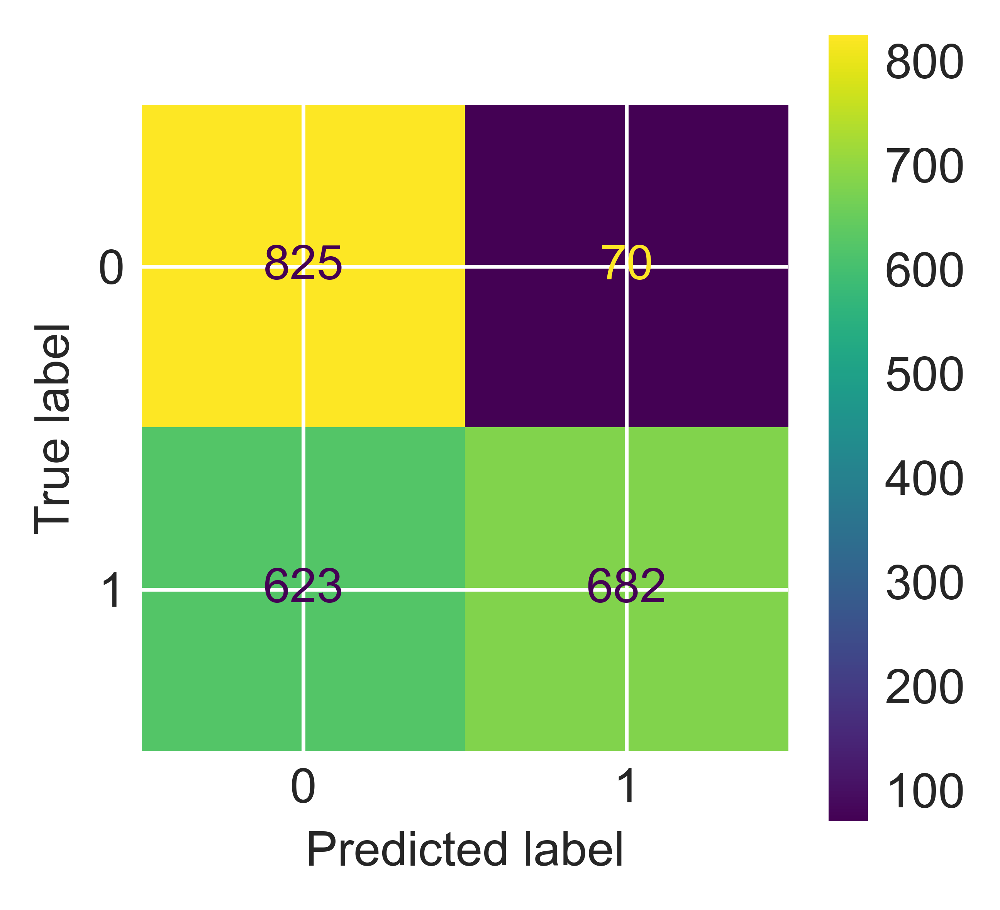

In [202]:
# Assuming y_test and y_pred_test are defined
conf_matrix = confusion_matrix(y_test, y_pred_test)

# Create a figure and a set of subplots with custom size
fig, ax = plt.subplots(figsize=(3, 3))  # Adjust the figure size as needed

# Plot the confusion matrix on the created axes
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix)
disp.plot(ax=ax)  # Pass the axes to the plot method

plt.show()

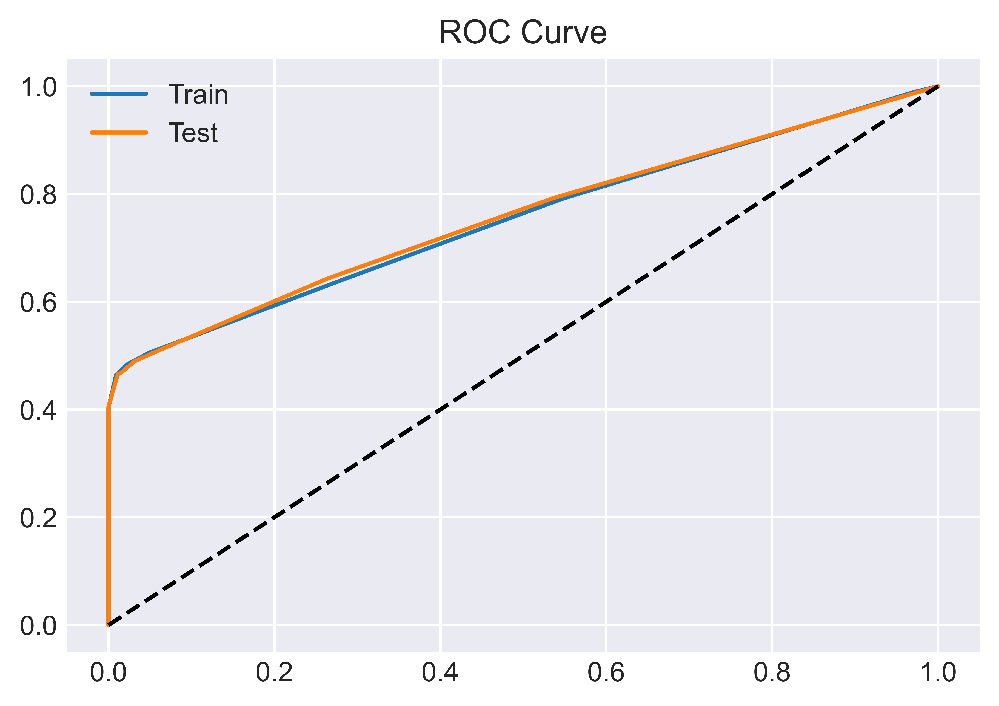

In [ ]:
y_test_score = tree_model.predict_proba(X_test)[:, 1]
y_train_score = tree_model.predict_proba(X_train)[:, 1]

test_fpr, test_tpr, thresholds = roc_curve(y_test, y_test_score)
train_fpr, train_tpr, thresholds = roc_curve(y_train, y_train_score)

# Plot the ROC curves
plt.plot(train_fpr, train_tpr, label='Train')
plt.plot(test_fpr, test_tpr, label='Test')
plt.plot([0, 1], [0, 1], 'k--')
plt.legend()
plt.title('ROC Curve')
plt.show()